In [1]:
import re
import time
from urllib.request import urlopen
import json
from pandas.io.json import json_normalize
import pandas as pd, numpy as np
import os
import requests
import datetime
import nltk
from nltk.tokenize.treebank import TreebankWordDetokenizer
from nltk.tokenize import sent_tokenize
nltk.download('punkt')

# word cleaning 
import string
import spacy
import scipy.sparse
from spacy.lang.en import English
from sklearn.feature_extraction.text import CountVectorizer
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS
from textwrap import wrap
from nltk.text import Text

# NLTK
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.corpus import wordnet as wn

from bertopic import BERTopic

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Shawn\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Shawn\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


# PreProcessing

In [2]:
df = pd.read_csv("../beforecovid.csv")
df

,Date,text,Year,Month,clean_text,join_clean_text,real_Date
0,25-Jan-19,"Mine is a 20 years resale flat, was top in 199...",19,Jan,"['mine', '20', 'years', 'resale', 'flat', 'top...",mine 20 years resale flat top 1999 got bomb sh...,2019-01-25
1,25-Jan-19,kimurayuki said:\r\nMine is a 20 years resale ...,19,Jan,"['kimurayuki', 'mine', '20', 'years', 'resale'...",kimurayuki mine 20 years resale flat top 1999 ...,2019-01-25
2,18-Jan-19,punggolbto said:\r\nAs per the actual HDB mode...,19,Jan,"['punggolbto', 'per', 'actual', 'hdb', 'models...",punggolbto per actual hdb models floor plans p...,2019-01-18
3,19-Oct-18,I have just purchased a resale flat recently w...,18,Oct,"['purchased', 'resale', 'flat', 'recently', 'w...",purchased resale flat recently without agent u...,2018-10-19
4,20-Oct-18,"Just to add, go to hdb website and check recen...",18,Oct,"['add', 'go', 'hdb', 'website', 'check', 'rece...",add go hdb website check recent 6mths resale t...,2018-10-20
...,...,...,...,...,...,...,...
13457,12-Oct-19,Van Holland Former Toho Mansion Holland Villag...,19,Oct,"['van', 'holland', 'former', 'toho', 'mansion'...",van holland former toho mansion holland villag...,2019-10-12
13458,13-Oct-19,Another project:\nFinal 15 units of T.O.P Read...,19,Oct,"['another', 'project', 'final', '15', 'units',...",another project final 15 units p ready boutiqu...,2019-10-13
13459,13-Oct-19,Zetrio2006 said:\nAnother project:\nFinal 15 u...,19,Oct,"['zetrio2006', 'another', 'project', 'final', ...",zetrio2006 another project final 15 units p re...,2019-10-13
13460,13-Oct-19,bolster said:\nWow... did you try walking to t...,19,Oct,"['bolster', 'wow', 'try', 'walking', 'holland'...",bolster wow try walking holland v mrt really 5...,2019-10-13


# clean contractions

In [3]:
# Dictionary of English Contractions
contractions_dict = { "ain't": "are not","'s":" is","aren't": "are not",
                     "can't": "cannot","can't've": "cannot have",
                     "'cause": "because","could've": "could have","couldn't": "could not",
                     "couldn't've": "could not have", "didn't": "did not","doesn't": "does not",
                     "don't": "do not","hadn't": "had not","hadn't've": "had not have",
                     "hasn't": "has not","haven't": "have not","he'd": "he would",
                     "he'd've": "he would have","he'll": "he will", "he'll've": "he will have",
                     "how'd": "how did","how'd'y": "how do you","how'll": "how will",
                     "I'd": "I would", "I'd've": "I would have","I'll": "I will",
                     "I'll've": "I will have","I'm": "I am","I've": "I have", "isn't": "is not",
                     "it'd": "it would","it'd've": "it would have","it'll": "it will",
                     "it'll've": "it will have", "let's": "let us","ma'am": "madam",
                     "mayn't": "may not","might've": "might have","mightn't": "might not", 
                     "mightn't've": "might not have","must've": "must have","mustn't": "must not",
                     "mustn't've": "must not have", "needn't": "need not",
                     "needn't've": "need not have","o'clock": "of the clock","oughtn't": "ought not",
                     "oughtn't've": "ought not have","shan't": "shall not","sha'n't": "shall not",
                     "shan't've": "shall not have","she'd": "she would","she'd've": "she would have",
                     "she'll": "she will", "she'll've": "she will have","should've": "should have",
                     "shouldn't": "should not", "shouldn't've": "should not have","so've": "so have",
                     "that'd": "that would","that'd've": "that would have", "there'd": "there would",
                     "there'd've": "there would have", "they'd": "they would",
                     "they'd've": "they would have","they'll": "they will",
                     "they'll've": "they will have", "they're": "they are","they've": "they have",
                     "to've": "to have","wasn't": "was not","we'd": "we would",
                     "we'd've": "we would have","we'll": "we will","we'll've": "we will have",
                     "we're": "we are","we've": "we have", "weren't": "were not","what'll": "what will",
                     "what'll've": "what will have","what're": "what are", "what've": "what have",
                     "when've": "when have","where'd": "where did", "where've": "where have",
                     "who'll": "who will","who'll've": "who will have","who've": "who have",
                     "why've": "why have","will've": "will have","won't": "will not",
                     "won't've": "will not have", "would've": "would have","wouldn't": "would not",
                     "wouldn't've": "would not have","y'all": "you all", "y'all'd": "you all would",
                     "y'all'd've": "you all would have","y'all're": "you all are",
                     "y'all've": "you all have", "you'd": "you would","you'd've": "you would have",
                     "you'll": "you will","you'll've": "you will have", "you're": "you are",
                     "you've": "you have"}

# Regular expression for finding contractions
contractions_re=re.compile('(%s)' % '|'.join(contractions_dict.keys()))

# Function for expanding contractions
def expand_contractions(text,contractions_dict=contractions_dict):
    def replace(match):
        return contractions_dict[match.group(0)]
    return contractions_re.sub(replace, text)


# Remove non-English words

# Expanding Contractions in the reviews
df["text"]=df["text"].apply(lambda x:expand_contractions(x))

# remove punc 
df['clean_text']  = df['text'].map(lambda x: re.sub("[^A-Za-z0-9]+"," ", str(x)))
# lower case
df['clean_text']  = df['clean_text'].apply(lambda x: x.lower())
# tokenize
df['clean_text']  = [word_tokenize(row) for row in df['clean_text']]

# remove stopwords
stop_words = stopwords.words('english')
stop_words.extend(['from', 'subject', 're', 'edu', 'use'])
def remove_stopwords(text):
    return [w for w in text if w not in stop_words]
df['clean_text']  = df['clean_text'].apply(lambda x: remove_stopwords(x))

df["join_clean_text"]=df["clean_text"].apply(lambda x:" ".join(x))

df.head()

,Date,text,Year,Month,clean_text,join_clean_text,real_Date
0,25-Jan-19,"Mine is a 20 years resale flat, was top in 199...",19,Jan,"[mine, 20, years, resale, flat, top, 1999, got...",mine 20 years resale flat top 1999 got bomb sh...,2019-01-25
1,25-Jan-19,kimurayuki said:\r\nMine is a 20 years resale ...,19,Jan,"[kimurayuki, said, mine, 20, years, resale, fl...",kimurayuki said mine 20 years resale flat top ...,2019-01-25
2,18-Jan-19,punggolbto said:\r\nAs per the actual HDB mode...,19,Jan,"[punggolbto, said, per, actual, hdb, models, f...",punggolbto said per actual hdb models floor pl...,2019-01-18
3,19-Oct-18,I have just purchased a resale flat recently w...,18,Oct,"[purchased, resale, flat, recently, without, a...",purchased resale flat recently without agent u...,2018-10-19
4,20-Oct-18,"Just to add, go to hdb website and check recen...",18,Oct,"[add, go, hdb, website, check, recent, 6mths, ...",add go hdb website check recent 6mths resale t...,2018-10-20


# lemmatization

In [4]:
# avoided lemmatization for bigram as the results are more interesting as it removes generating words like 4rooms within1km which are not included in the allowed postags
from nltk.util import ngrams
def make_bigrams(texts):
    texts = [" ".join(w) for w in ngrams(texts, 2)]
    return texts

df['clean_text'] = df['clean_text'].apply(lambda x: make_bigrams(x))

data_lemmatized = df['clean_text'].tolist()

# nlp = spacy.load("en_core_web_sm")
# lemmatization
# def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
#     texts_out = []
#     print(texts[0])
#     doc = nlp(' '.join(str(v) for v in texts)) 
#     for token in doc:
#         if token.pos_ in allowed_postags:
#             texts_out.append(token.lemma_)

#     return texts_out
# df_assigned['clean_text'] = df_assigned['clean_text'].head().apply(lambda x: lemmatization(x))

In [5]:
df.head()

,Date,text,Year,Month,clean_text,join_clean_text,real_Date
0,25-Jan-19,"Mine is a 20 years resale flat, was top in 199...",19,Jan,"[mine 20, 20 years, years resale, resale flat,...",mine 20 years resale flat top 1999 got bomb sh...,2019-01-25
1,25-Jan-19,kimurayuki said:\r\nMine is a 20 years resale ...,19,Jan,"[kimurayuki said, said mine, mine 20, 20 years...",kimurayuki said mine 20 years resale flat top ...,2019-01-25
2,18-Jan-19,punggolbto said:\r\nAs per the actual HDB mode...,19,Jan,"[punggolbto said, said per, per actual, actual...",punggolbto said per actual hdb models floor pl...,2019-01-18
3,19-Oct-18,I have just purchased a resale flat recently w...,18,Oct,"[purchased resale, resale flat, flat recently,...",purchased resale flat recently without agent u...,2018-10-19
4,20-Oct-18,"Just to add, go to hdb website and check recen...",18,Oct,"[add go, go hdb, hdb website, website check, c...",add go hdb website check recent 6mths resale t...,2018-10-20


# Bertopic

In [6]:
# pip install python-dev-tools --user --upgrade


In [7]:
# !pip3 install bertopic
# pip install bertopic --user

**Wordcloud**

In [8]:
#wordcloud code
import matplotlib.pyplot as plt

def create_wordcloud(topic_model, topic):
    text = {word: value for word, value in topic_model.get_topic(topic)}
    wc = WordCloud(background_color="white", max_words=1000)
    wc.generate_from_frequencies(text)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()


In [9]:
df["join_clean_text"][1:20]

1     kimurayuki said mine 20 years resale flat top ...
2     punggolbto said per actual hdb models floor pl...
3     purchased resale flat recently without agent u...
4     add go hdb website check recent 6mths resale t...
5     xyz2025 said purchased resale flat recently wi...
6     polar bear king said good luck rental investor...
7     polar bear king said good luck rental investor...
8     holasingapura said calling budget hotel 70 sol...
9     aiyahwhatever said may random fleeting thought...
10    forever84 said want honest opinion unless u wa...
11    passerboy said think high amount 68 70 high go...
12    pruyeo said contrary common belief singapore h...
13    d5dude said data q1 economy stock market start...
14    1993newbie said 3 penthouse sold recent months...
15    got international school nearby drkcynic said ...
16    surferpunk said sorry digress us fee already c...
17    rider83 said interesting observations stagnant...
18    rider83 said interesting observations stag

**Bigram**

In [10]:
text = df["join_clean_text"].to_list()
topic_model_bi = BERTopic( n_gram_range=(2,2), verbose=True)
topics_bi, _ = topic_model_bi.fit_transform(text)

Batches:   0%|          | 0/421 [00:00<?, ?it/s]

2022-10-27 23:54:07,782 - BERTopic - Transformed documents to Embeddings
2022-10-27 23:54:35,985 - BERTopic - Reduced dimensionality
2022-10-27 23:54:37,187 - BERTopic - Clustered reduced embeddings


In [11]:
freq_bi = topic_model_bi.get_topic_info()
freq_bi["Name"][1]

'0_west sun_service yard_windwaver said_251 253'

In [12]:
freq_bi

,Topic,Count,Name
0,-1,5874,-1_click expand_mrt station_near mrt_property ...
1,0,182,0_west sun_service yard_windwaver said_251 253
2,1,176,1_seller agent_buyer agent_pay commission_agen...
3,2,168,2_hawker centre_wet market_supermarket shops_g...
4,3,161,3_canberra mrt_mrt station_parc canberra_canbe...
...,...,...,...
275,274,10,274_yishun room_stay right_right beside_buy sell
276,275,10,275_leh imo_haha impt_best walking_imo want
277,276,10,276_industrial factory_eunos plot_said eunos_u...
278,277,10,277_entire margaret_moe even_storey hawker_plu...


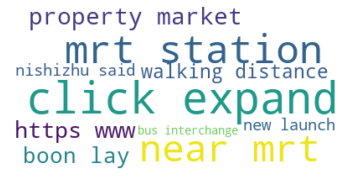

In [13]:
create_wordcloud(topic_model_bi,topic=-1)

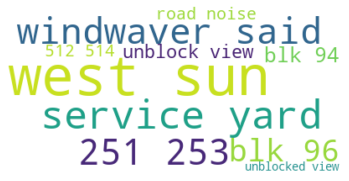

In [14]:
create_wordcloud(topic_model_bi,topic=0)

In [15]:
topic_nr_bi = freq_bi.iloc[1]["Topic"]

In [16]:
topic_nr_bi = freq_bi.iloc[1]["Topic"] # select a frequent topic
topic_model_bi.get_topic(topic_nr_bi)

[('west sun', 0.025466318995160792),
 ('service yard', 0.011692212423870384),
 ('windwaver said', 0.009845304388853976),
 ('251 253', 0.0096914014609904),
 ('blk 96', 0.009113915139380601),
 ('blk 94', 0.008299023784993533),
 ('unblock view', 0.006303186438702358),
 ('road noise', 0.005277673932585576),
 ('512 514', 0.005079822136878632),
 ('unblocked view', 0.004852349697810277)]

# Results


Get docs by topic number

In [17]:
topic_model_bi.get_representative_docs(topic=1)

['spicynuggets said idea 2nd agent hired well known malay agent expecting break malay market 5 viewings 0 malay hmm interesting would hv thinking u shoes hire malay agent break malay market surprising hear even 1 malay viewer achieved',
 'rmcwmr said normally developer appoint agency sell agents e g capitaland appoint huttons era manage market projects developers want deal individual buyers leave agency manage buying condo would recommend using agent one trust free anyway get kickback agent illegal get discount agent see free service see downside using except make sure agent trustworthy sway buying something want',
 'annetyu said say true agent really despicable yah dun understand agents nowaday still wan na play fear low supply high demand increasing prices bull market etc etc sincere pp wont turned usually type agent cmi zero sales retirees like mine haha']

List of topics

In [18]:
topic_model_bi.get_topics()

{-1: [('click expand', 0.0024065630218214466),
  ('mrt station', 0.001931778956784283),
  ('near mrt', 0.00172641027235113),
  ('property market', 0.0015072860708727597),
  ('https www', 0.0014040070488747563),
  ('boon lay', 0.0013317645432517886),
  ('walking distance', 0.0012315359382858164),
  ('nishizhu said', 0.0011577285281365514),
  ('new launch', 0.0011461983646959516),
  ('bus interchange', 0.0011289522081062817)],
 0: [('west sun', 0.025466318995160792),
  ('service yard', 0.011692212423870384),
  ('windwaver said', 0.009845304388853976),
  ('251 253', 0.0096914014609904),
  ('blk 96', 0.009113915139380601),
  ('blk 94', 0.008299023784993533),
  ('unblock view', 0.006303186438702358),
  ('road noise', 0.005277673932585576),
  ('512 514', 0.005079822136878632),
  ('unblocked view', 0.004852349697810277)],
 1: [('seller agent', 0.00884651929107259),
  ('buyer agent', 0.008284323003933131),
  ('pay commission', 0.007468683379472452),
  ('agent help', 0.007335561513367403),
  ('

In [19]:
topic_model_bi.get_topic_info()

,Topic,Count,Name
0,-1,5874,-1_click expand_mrt station_near mrt_property ...
1,0,182,0_west sun_service yard_windwaver said_251 253
2,1,176,1_seller agent_buyer agent_pay commission_agen...
3,2,168,2_hawker centre_wet market_supermarket shops_g...
4,3,161,3_canberra mrt_mrt station_parc canberra_canbe...
...,...,...,...
275,274,10,274_yishun room_stay right_right beside_buy sell
276,275,10,275_leh imo_haha impt_best walking_imo want
277,276,10,276_industrial factory_eunos plot_said eunos_u...
278,277,10,277_entire margaret_moe even_storey hawker_plu...


# Coherence Score

**Bigram**

In [21]:
from bertopic import BERTopic
import gensim.corpora as corpora
from gensim.models.coherencemodel import CoherenceModel

# text = dfs[2].lemmatized.to_list()
# dates = dfs[2]['Date'].apply(lambda x: pd.Timestamp(x)).to_list()

topic_model = BERTopic(verbose=True, n_gram_range=(2, 2))
topics, _ = topic_model.fit_transform(text)

# Preprocess Documents
documents = pd.DataFrame({"Document": text,
                          "ID": range(len(text)),
                          "Topic": topics})
documents_per_topic = documents.groupby(['Topic'], as_index=False).agg({'Document': ' '.join})
cleaned_docs = topic_model._preprocess_text(documents_per_topic.Document.values)

# Extract vectorizer and analyzer from BERTopic
vectorizer = topic_model.vectorizer_model
analyzer = vectorizer.build_analyzer()

# Extract features for Topic Coherence evaluation
words = vectorizer.get_feature_names()
tokens = [analyzer(doc) for doc in cleaned_docs]
dictionary = corpora.Dictionary(tokens)
corpus = [dictionary.doc2bow(token) for token in tokens]
topic_words = [[words for words, _ in topic_model.get_topic(topic)] 
               for topic in range(len(set(topics))-1)]

# Evaluate
coherence_model = CoherenceModel(topics=topic_words, 
                                 texts=tokens, 
                                 corpus=corpus,
                                 dictionary=dictionary, 
                                 coherence='c_v')
coherence = coherence_model.get_coherence()

Batches:   0%|          | 0/421 [00:00<?, ?it/s]

2022-10-28 00:02:57,446 - BERTopic - Transformed documents to Embeddings
2022-10-28 00:03:04,417 - BERTopic - Reduced dimensionality
2022-10-28 00:03:05,204 - BERTopic - Clustered reduced embeddings


In [22]:
print(coherence)

0.7757309001943998


In [23]:
topic_model.get_topic_info()

,Topic,Count,Name
0,-1,5832,-1_click expand_near mrt_mrt station_property ...
1,0,239,0_canberra mrt_mrt station_parc canberra_sapph...
2,1,208,1_west sun_service yard_windwaver said_251 253
3,2,200,2_seller agent_buyer agent_agent help_pay comm...
4,3,152,3_keat hong_jurong region_region line_cck mrt
...,...,...,...
271,270,11,270_chinese sell_maybe stage_level individual_...
272,271,11,271_cambodia property_payment terms_dollars cu...
273,272,10,272_appointment view_jalan bukit_showflat besi...
274,273,10,273_parc central_central residences_western re...


In [24]:
# print(coherence)

# Visualization


**Intertopic Distance Map**

---



In [25]:
topic_model.visualize_topics()

**Hierachical Clustering**

---



In [26]:
topic_model.visualize_hierarchy()

**Word scores**

---



In [27]:
topic_model.visualize_barchart()

**Word Count**

---



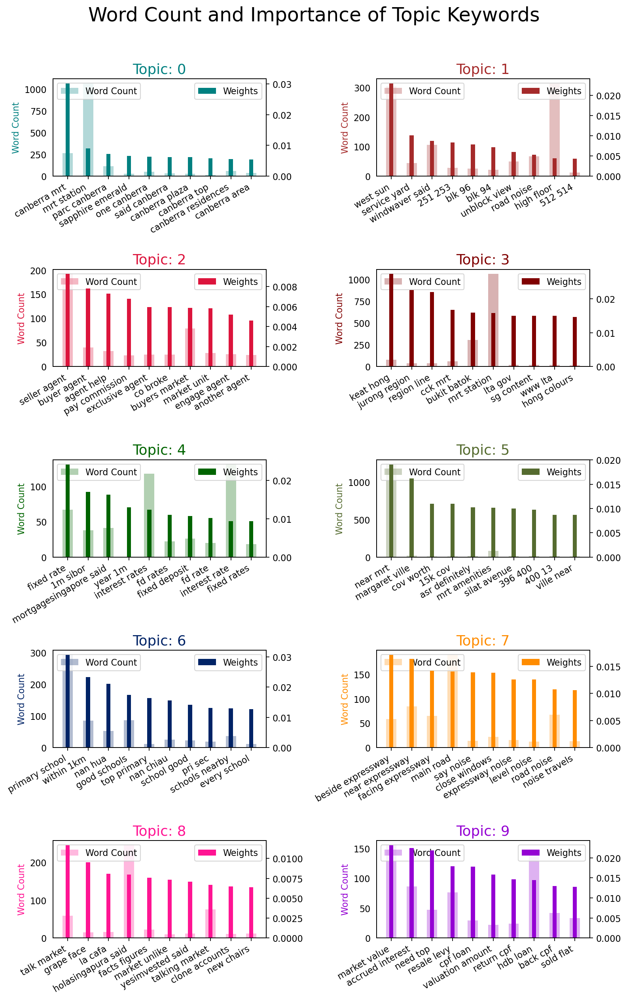

In [28]:
from collections import Counter

topics = topic_model.get_topics()
topics = {k:topics[k] for k in (0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20) if k in topics}
data_flat = [w for w_list in data_lemmatized for w in w_list]
counter = Counter(data_flat)
ntopics_des_name = 10

out = []
for i, topic in topics.items():
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df_word = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])        

# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(5,2, figsize=(10,15), dpi=160,facecolor='white')
cols = ['#008080', '#A52A2A', '#DC143C', '#800000', '#006400', '#556b2f', '#002366', '#ff8c00', '#FF1493', '#9400D3',
        '#ba55d3', '#b8860b', '#C71585', '#00ff7f', '#00004C', '#00008B', '#B8860B', '#DEB887', '#8A2BE2', '#1b364a']

for i, ax in enumerate(axes.flatten()):
    if i > ntopics_des_name - 1: # break when all topics are shown
        break
    ax.bar(x='word', height="word_count", data=df_word.loc[df_word.topic_id==i, :], color=cols[i], width=0.5, alpha=0.3, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df_word.loc[df_word.topic_id==i, :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    ax.set_title('Topic: ' + str(i), color=cols[i], fontsize=16)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df_word.loc[df_word.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')


fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Topic Keywords', fontsize=22, y=1.05)    
plt.savefig('bigram_bert_topics_before.png',facecolor=fig.get_facecolor(), transparent=True)
plt.show()

